# P5 - Vehicle Detection Project


---

## Step 1: Dataset Exploration

Read in car and non car images from dataset and display information about dataset.

In [1]:
# Read data set folder and display information on data set
import glob
import scipy.misc

car = glob.glob('vehicles/vehicles/**/*.png')
non_car = glob.glob('non-vehicles/non-vehicles/**/*.png')

car_image = []
non_car_image = []

for f_path in car:
    car_image.append(scipy.misc.imread(f_path,flatten=False, mode='RGB'))
for f_path in non_car:
    non_car_image.append(scipy.misc.imread(f_path, flatten=False, mode='RGB'))
    
n_car = len(car_image)
n_non_car = len(non_car_image)
    
print('Number of car images:', n_car, 'with shape', car_image[0].shape)
print('Number of non car images:', n_non_car, 'with shape', non_car_image[0].shape)

print('Done')



Number of car images: 8792 with shape (64, 64, 3)
Number of non car images: 9666 with shape (64, 64, 3)
Done


## Step 2: Display 50 random car and non car images for sampling and verification

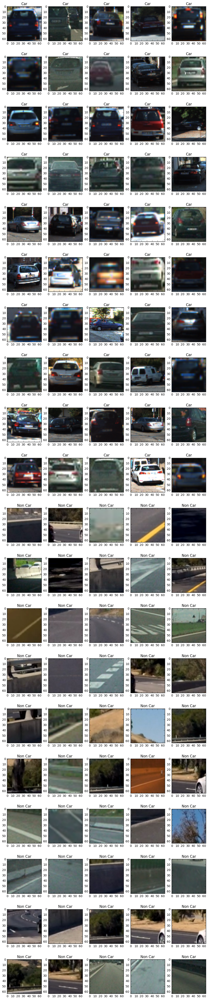

Done


In [2]:
"""
Display of 50 images for each data set for sampling
"""

%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np

# Display images in a 11 x 4 plot
fig = plt.figure(figsize=(12, 60))

for i in range(50):
    fig.add_subplot(20, 5, i+1)
    plt.imshow(car_image[np.random.randint(0, n_car)])
    plt.title('Car')
    
for i in range(50):
    fig.add_subplot(20, 5, i+51)
    plt.imshow(non_car_image[np.random.randint(0, n_non_car)])
    plt.title('Non Car')

fig.savefig('output_images/CarvsNonCar.png')
plt.show()

print('Done')

## Step 3: Plot scatter plot of car and non car images

Scatter plot of car and non car images are plotted for RGB, HSV, HLS and LUV for visualization of car and non car images in different color spaces. This is done to pick the color scheme that provides greatest differentiation between car and non car images. In this case, HSV is selected.

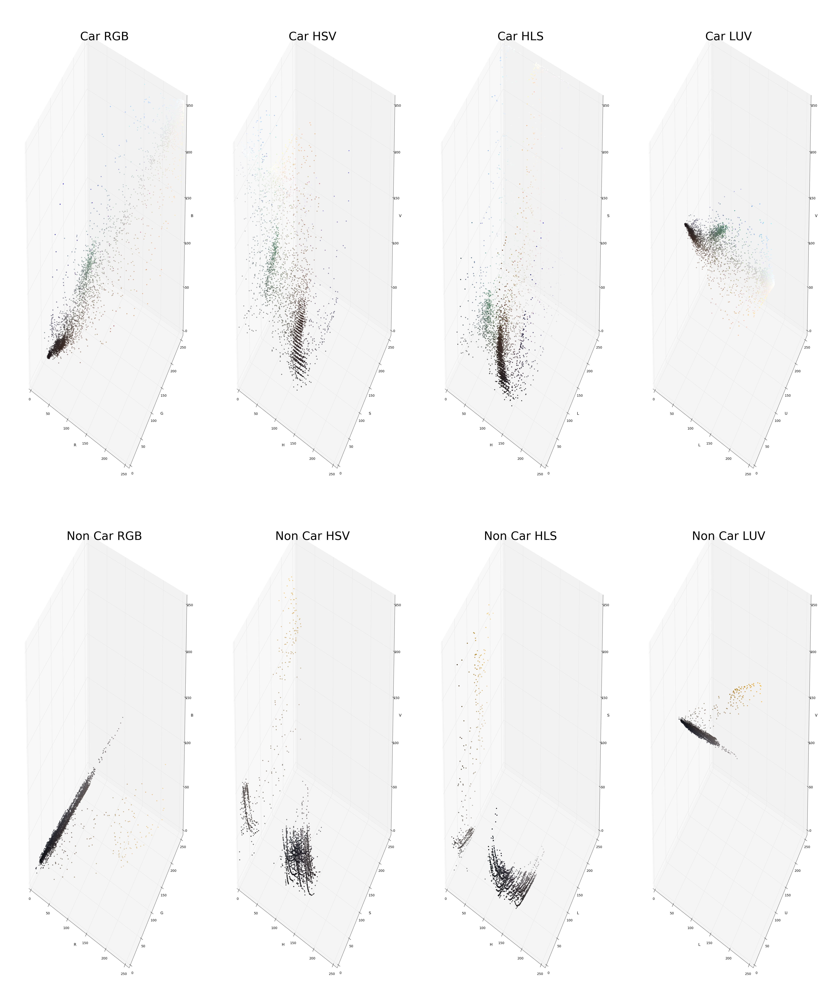

Done


In [3]:
"""
Reusing code from lesson 22 for plotting of graphs
"""

import cv2
from mpl_toolkits.mplot3d import Axes3D

def plot3d(pixels, colors_rgb, ax,
        axis_labels=list("RGB"), axis_limits=[(0, 255), (0, 255), (0, 255)]):
    
    """Plot pixels in 3D."""

    # Create figure and 3D axes
    #fig = plt.figure(figsize=(8, 8))
    #ax = Axes3D(fig)

    # Set axis limits
    ax.set_xlim(*axis_limits[0])
    ax.set_ylim(*axis_limits[1])
    ax.set_zlim(*axis_limits[2])

    # Set axis labels and sizes
    ax.tick_params(axis='both', which='major', labelsize=14, pad=8)
    ax.set_xlabel(axis_labels[0], fontsize=16, labelpad=16)
    ax.set_ylabel(axis_labels[1], fontsize=16, labelpad=16)
    ax.set_zlabel(axis_labels[2], fontsize=16, labelpad=16)

    # Plot pixel values with colors given in colors_rgb
    ax.scatter(
        pixels[:, :, 0].ravel(),
        pixels[:, :, 1].ravel(),
        pixels[:, :, 2].ravel(),
        c=colors_rgb.reshape((-1, 3)), edgecolors='none')

    return ax  # return Axes3D object for further manipulation


# Read a color image
img = cv2.imread(car[np.random.randint(0, n_car)])

# Select a small fraction of pixels to plot by subsampling it
scale = max(img.shape[0], img.shape[1], 64) / 64  # at most 64 rows and columns
img_small = cv2.resize(img, (np.int(img.shape[1] / scale), np.int(img.shape[0] / scale)), interpolation=cv2.INTER_NEAREST)

# Convert subsampled image to desired color space(s)
img_small_RGB = img_small  # OpenCV uses BGR, matplotlib likes RGB
img_small_HSV = cv2.cvtColor(img_small, cv2.COLOR_BGR2HSV)
img_small_HLS = cv2.cvtColor(img_small, cv2.COLOR_BGR2HLS)
img_small_LUV = cv2.cvtColor(img_small, cv2.COLOR_BGR2LUV)
img_small_rgb = img_small_RGB / 255.  # scaled to [0, 1], only for plotting

fig = plt.figure(figsize=(50, 60))

# Plot and show
ax1 = fig.add_subplot(241, projection='3d')
plot3d(img_small_RGB, img_small_rgb, ax1)
plt.title('Car RGB', fontsize=50)

ax2 = fig.add_subplot(242, projection='3d')
plot3d(img_small_HSV, img_small_rgb , ax2, axis_labels = list("HSV"))
plt.title('Car HSV', fontsize=50)

ax3 = fig.add_subplot(243, projection='3d')
plot3d(img_small_HLS, img_small_rgb , ax3, axis_labels = list("HLS"))
plt.title('Car HLS', fontsize=50)

ax4 = fig.add_subplot(244, projection='3d')
plot3d(img_small_LUV, img_small_rgb , ax4, axis_labels = list("LUV"))
plt.title('Car LUV', fontsize=50)

###################################################

# Read a color image
img = cv2.imread(non_car[np.random.randint(0, n_non_car)])

# Select a small fraction of pixels to plot by subsampling it
scale = max(img.shape[0], img.shape[1], 64) / 64  # at most 64 rows and columns
img_small = cv2.resize(img, (np.int(img.shape[1] / scale), np.int(img.shape[0] / scale)), interpolation=cv2.INTER_NEAREST)

# Convert subsampled image to desired color space(s)
img_small_RGB = cv2.cvtColor(img_small, cv2.COLOR_BGR2RGB)  # OpenCV uses BGR, matplotlib likes RGB
img_small_HSV = cv2.cvtColor(img_small, cv2.COLOR_BGR2HSV)
img_small_HLS = cv2.cvtColor(img_small, cv2.COLOR_BGR2HLS)
img_small_LUV = cv2.cvtColor(img_small, cv2.COLOR_BGR2LUV)
img_small_rgb = img_small_RGB / 255.  # scaled to [0, 1], only for plotting

# Plot and show
ax1 = fig.add_subplot(245, projection='3d')
plot3d(img_small_RGB, img_small_rgb, ax1)
plt.title('Non Car RGB', fontsize=50)

ax2 = fig.add_subplot(246, projection='3d')
plot3d(img_small_HSV, img_small_rgb , ax2, axis_labels = list("HSV"))
plt.title('Non Car HSV', fontsize=50)

ax3 = fig.add_subplot(247, projection='3d')
plot3d(img_small_HLS, img_small_rgb , ax3, axis_labels = list("HLS"))
plt.title('Non Car HLS', fontsize=50)

ax4 = fig.add_subplot(248, projection='3d')
plot3d(img_small_LUV, img_small_rgb , ax4, axis_labels = list("LUV"))
plt.title('Non Car LUV', fontsize=50)

plt.tight_layout()
fig.savefig('output_images/CarvsNonCar_RGB_HSV_HLS_LUV.png')
plt.show()

print('Done')


## Step 4: HOG Feature Extraction

Hog feature extraction is implemented and visualized to verify the correct implementation of extraction.

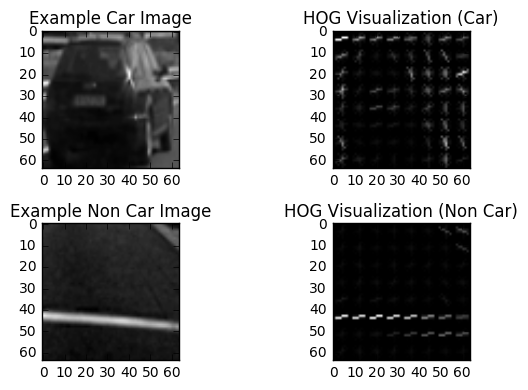

In [4]:
"""
Implement hog
"""

import numpy as np
from skimage.feature import hog
        
# function to return HOG features and visualization
def get_hog_features(img, orient, pix_per_cell, cell_per_block, vis=False, feature_vec=True):
    if vis == True:
        features, hog_image = hog(img, orientations=orient, pixels_per_cell=(pix_per_cell, pix_per_cell),
                                  cells_per_block=(cell_per_block, cell_per_block), transform_sqrt=True, 
                                  visualise=True, feature_vector=False)
        return features, hog_image
    else:      
        features = hog(img, orientations=orient, pixels_per_cell=(pix_per_cell, pix_per_cell),
                       cells_per_block=(cell_per_block, cell_per_block), transform_sqrt=True, 
                       visualise=False, feature_vector=feature_vec)
        return features

# Generate a random index to look at a car image
ind = np.random.randint(0, n_car)
ind2 = np.random.randint(0, n_non_car)
# Read in the image
gray_car = cv2.cvtColor(car_image[ind], cv2.COLOR_RGB2GRAY)
gray_non_car = cv2.cvtColor(non_car_image[ind2], cv2.COLOR_RGB2GRAY)
# Define HOG parameters
orient = 9
pix_per_cell = 8
cell_per_block = 2
# Call function with vis=True to see an image output
features_car, hog_image_car = get_hog_features(gray_car, orient, 
                        pix_per_cell, cell_per_block, 
                        vis=True, feature_vec=False)

features_non_car, hog_image_non_car = get_hog_features(gray_non_car, orient, 
                        pix_per_cell, cell_per_block, 
                        vis=True, feature_vec=False)


# Plot the examples
fig = plt.figure()
plt.subplot(221)
plt.imshow(gray_car, cmap='gray')
plt.title('Example Car Image')
plt.subplot(222)
plt.imshow(hog_image_car, cmap='gray')
plt.title('HOG Visualization (Car)')
plt.subplot(223)
plt.imshow(gray_non_car, cmap='gray')
plt.title('Example Non Car Image')
plt.subplot(224)
plt.imshow(hog_image_non_car, cmap='gray')
plt.title('HOG Visualization (Non Car)')
plt.tight_layout()
fig.savefig('output_images/CarvsNonCar_Hog.png')
plt.show()


## Step 5: Combine and normalize features

Done


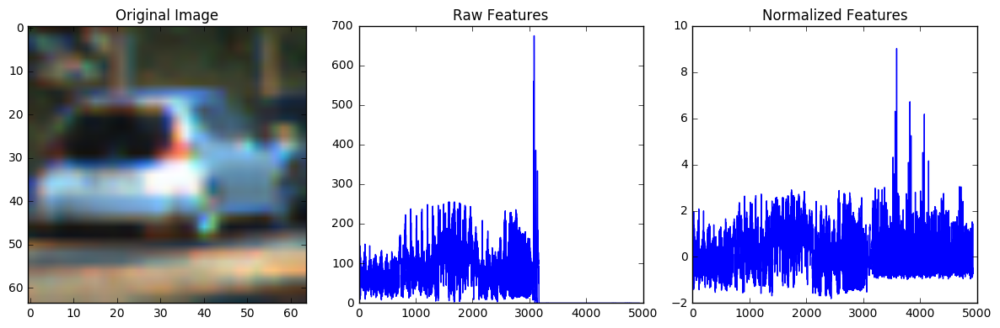

In [5]:
from sklearn.preprocessing import StandardScaler

# function to compute binned color features  
def bin_spatial(img, size=(32, 32)):
    # Use cv2.resize().ravel() to create the feature vector
    features = cv2.resize(img, size).ravel() 
    # Return the feature vector
    return features

# function to compute color histogram features  
def color_hist(img, nbins=32, bins_range=(0, 256)):
    # Compute the histogram of the color channels separately
    channel1_hist = np.histogram(img[:,:,0], bins=nbins, range=bins_range)
    channel2_hist = np.histogram(img[:,:,1], bins=nbins, range=bins_range)
    channel3_hist = np.histogram(img[:,:,2], bins=nbins, range=bins_range)
    # Concatenate the histograms into a single feature vector
    hist_features = np.concatenate((channel1_hist[0], channel2_hist[0], channel3_hist[0]))
    # Return the individual histograms, bin_centers and feature vector
    return hist_features

# function to extract features from a list of images
# function call bin_spatial(), color_hist() and get_hog_features()
def extract_features(imgs, cspace='RGB', spatial_size=(32, 32),
                        hist_bins=32, hist_range=(0, 256)):
    # Create a list to append feature vectors to
    features = []
    # Iterate through the list of images
    for image in imgs:
        # Read in each one by one
        # apply color conversion if other than 'RGB'
        if cspace != 'RGB':
            if cspace == 'HSV':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
            elif cspace == 'LUV':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2LUV)
            elif cspace == 'HLS':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
            elif cspace == 'YUV':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2YUV)
        else: feature_image = np.copy(image)      
        # Apply bin_spatial() to get spatial color features
        spatial_features = bin_spatial(feature_image, size=spatial_size)
        # Apply color_hist() also with a color space option now
        hist_features = color_hist(feature_image, nbins=hist_bins, bins_range=hist_range)
        # Apply get_hog_features()
        gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
        hog_features = get_hog_features(gray, orient, pix_per_cell, cell_per_block, vis=False, feature_vec=True)
        # Append the new feature vector to the features list
        features.append(np.concatenate((spatial_features, hist_features, hog_features)))
        #features.append(hog_features)
    # Return list of feature vectors
    return features

color_space = 'HSV'

car_features = extract_features(car_image, cspace=color_space, spatial_size=(32, 32),
                        hist_bins=32, hist_range=(0, 256))
non_car_features = extract_features(non_car_image, cspace=color_space, spatial_size=(32, 32),
                        hist_bins=32, hist_range=(0, 256))

if len(car_features) > 0:
    # Create an array stack of feature vectors
    X = np.vstack((car_features, non_car_features)).astype(np.float64)                        
    # Fit a per-column scaler
    X_scaler = StandardScaler().fit(X)
    # Apply the scaler to X
    scaled_X = X_scaler.transform(X)
    car_ind = np.random.randint(0, n_car)
    # Plot an example of raw and scaled features
    fig = plt.figure(figsize=(12,4))
    plt.subplot(131)
    plt.imshow(car_image[car_ind])
    plt.title('Original Image')
    plt.subplot(132)
    plt.plot(X[car_ind])
    plt.title('Raw Features')
    plt.subplot(133)
    plt.plot(scaled_X[car_ind])
    plt.title('Normalized Features')
    fig.tight_layout() 
    fig.savefig('output_images/Car_Raw_Normalized.png')
else: 
    print('Your function only returns empty feature vectors...')
    
print('Done')

## Step 6: Prepare dataset for training

In [6]:
"""
Prepare data for training
"""

from sklearn.model_selection import train_test_split

labels_car = np.ones(n_car, dtype=np.int)
label_non_car = np.zeros(n_non_car, dtype=np.int)

features_train = scaled_X
labels_train = np.concatenate((labels_car,label_non_car))

features_train, features_test, labels_train, labels_test = train_test_split(
    features_train,
    labels_train,
    test_size=0.1,
    random_state=8289)


print('Size of Training Set:', features_train.shape[0])
print('Size of Test Set:', features_test.shape[0])

Size of Training Set: 16612
Size of Test Set: 1846


## Step 7: Train model using Support Vector Machine

In [7]:
"""
Training block
"""

########################## SVM #################################
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score
import time

# increase in C parameter leads to better fit but also overfitting to training set
# low gamma values consider points further from line. high gamma values considers only points closest to line 
svc = SVC(kernel="linear", probability=False)

# Threshold value for decision function used for reducing false positive
decision_threshold = 0.5

# fit the classifier
t=time.time()
svc.fit(features_train, labels_train) 
t2 = time.time()
print(round(t2-t, 2), 'Seconds to train SVC...')

print('Classifier class order:', svc.classes_)

# make predictions in a list named pred
t=time.time()
pred = svc.predict(features_test)
t2 = time.time()
print(round(t2-t, 2), 'Seconds to make prediction using simple prediction on test sample...')

# make predictions using decision function in a list named pred_decfn
t=time.time()
pred_decfn = []
dec = svc.decision_function(features_test)
for i in dec:
    if i > decision_threshold:
        pred_decfn.append(1)
    else:
        pred_decfn.append(0)
pred_decfn = np.array(pred_decfn)
t2 = time.time()
print(round(t2-t, 2), 'Seconds to make prediction using decision function on test sample...')

acc = accuracy_score(pred, labels_test)
print('Test Accuracy of SVC for color space using prediction', color_space ,' = ', round(acc, 4))

acc = accuracy_score(pred_decfn, labels_test)
print('Test Accuracy of SVC for color space using decision function', color_space ,' = ', round(acc, 4))


99.56 Seconds to train SVC...
Classifier class order: [0 1]
8.9 Seconds to make prediction using simple prediction on test sample...
8.88 Seconds to make prediction using decision function on test sample...
Test Accuracy of SVC for color space using prediction HSV  =  0.9865
Test Accuracy of SVC for color space using decision function HSV  =  0.9816


## Step 8: Implement and visualize sliding window

Done


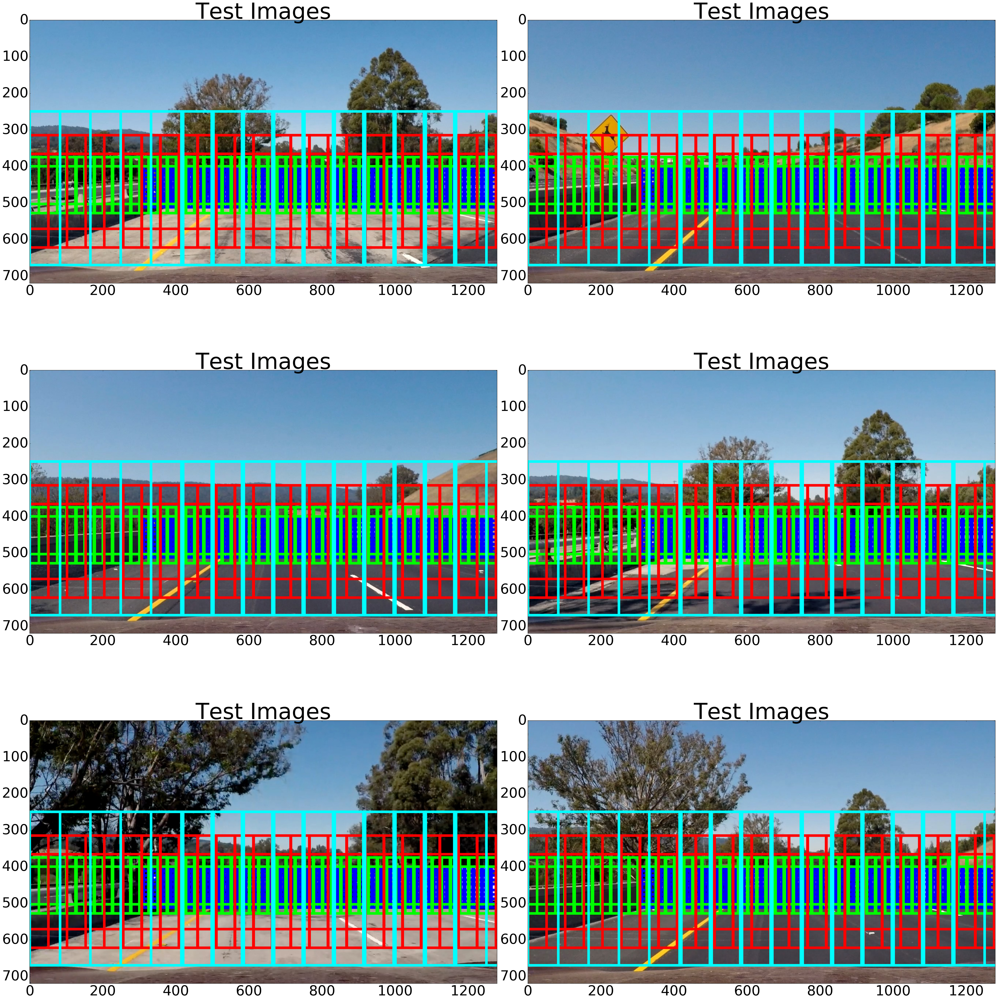

In [8]:
"""
Sliding window using multi scale and run each scale at a specific region of image

Code from Udacity Course
"""

# Here is your draw_boxes function from the previous exercise
def draw_boxes(img, bboxes, color=(0, 0, 255), thick=6):
    # Make a copy of the image
    imcopy = np.copy(img)
    # Iterate through the bounding boxes
    for bbox in bboxes:
        # Draw a rectangle given bbox coordinates
        cv2.rectangle(imcopy, bbox[0], bbox[1], color, thick)
    # Return the image copy with boxes drawn
    return imcopy
    
    
# Define a function that takes an image,
# start and stop positions in both x and y, 
# window size (x and y dimensions),  
# and overlap fraction (for both x and y)
def slide_window(img, x_start_stop=[None, None], y_start_stop=[None, None], 
                    xy_window=(64, 64), xy_overlap=(0.5, 0.5)):
    # If x and/or y start/stop positions not defined, set to image size
    if x_start_stop[0] == None:
        x_start_stop[0] = 0
    if x_start_stop[1] == None:
        x_start_stop[1] = img.shape[1]
    if y_start_stop[0] == None:
        y_start_stop[0] = 0
    if y_start_stop[1] == None:
        y_start_stop[1] = img.shape[0]
    # Compute the span of the region to be searched    
    xspan = x_start_stop[1] - x_start_stop[0]
    yspan = y_start_stop[1] - y_start_stop[0]
    # Compute the number of pixels per step in x/y
    nx_pix_per_step = np.int(xy_window[0]*(1 - xy_overlap[0]))
    ny_pix_per_step = np.int(xy_window[1]*(1 - xy_overlap[1]))
    # Compute the number of windows in x/y
    nx_windows = np.int(xspan/nx_pix_per_step) #- 1
    ny_windows = np.int(yspan/ny_pix_per_step) #- 1
    # Initialize a list to append window positions to
    window_list = []
    # Loop through finding x and y window positions
    # Note: you could vectorize this step, but in practice
    # you'll be considering windows one by one with your
    # classifier, so looping makes sense
    for ys in range(ny_windows):
        for xs in range(nx_windows):
            # Calculate window position
            startx = xs*nx_pix_per_step + x_start_stop[0]
            endx = startx + xy_window[0]
            starty = ys*ny_pix_per_step + y_start_stop[0]
            endy = starty + xy_window[1]
            # Append window position to list
            window_list.append(((startx, starty), (endx, endy)))
    # Return the list of windows
    return window_list

test_images_window = []
test_images = glob.glob('test_images/*.jpg')

for f_path in test_images:
    image = scipy.misc.imread(f_path,flatten=False, mode='RGB')

    windows = slide_window(image, x_start_stop=[300, None], y_start_stop=[400, 464], 
                        xy_window=(64, 64), xy_overlap=(0.8, 0.8))

    window_img = draw_boxes(image, windows, color=(0, 0, 255), thick=6)  
    
    windows = slide_window(image, x_start_stop=[None, None], y_start_stop=[375, 427], 
                        xy_window=(128, 128), xy_overlap=(0.8, 0.8))

    window_img = draw_boxes(window_img, windows, color=(0, 255, 0), thick=6) 
    
    windows = slide_window(image, x_start_stop=[None, None], y_start_stop=[315, 418], 
                        xy_window=(256, 256), xy_overlap=(0.8, 0.8))

    window_img = draw_boxes(window_img, windows, color=(255, 0, 0), thick=6) 
    
    windows = slide_window(image, x_start_stop=[None, None], y_start_stop=[250, 350], 
                        xy_window=(420, 420), xy_overlap=(0.8, 0.8))

    window_img = draw_boxes(window_img, windows, color=(0, 255, 255), thick=6) 
    
    
    test_images_window.append(window_img)

fig = plt.figure(figsize=(50, 60))

for i in range(len(test_images_window)):
    ax = fig.add_subplot(3, 2, i+1)
    plt.imshow(test_images_window[i])
    plt.xticks(fontsize = 50)
    plt.yticks(fontsize = 50)
    plt.title('Test Images', fontsize=80)
    plt.tight_layout()

fig.savefig('output_images/TestWindows_Drawn.png')

print('Done')

## Step 9: Define function for detection

In [9]:
"""
Codes adapted from Udacity Course and changed to fit algorithm
"""

from scipy.ndimage.measurements import label

def single_img_features(imgs, cspace='RGB', spatial_size=(32, 32),
                        hist_bins=32, hist_range=(0, 256)):
    # Create a list to append feature vectors to
    features = []
    # Read in each one by one
    # apply color conversion if other than 'RGB'
    if cspace != 'RGB':
        if cspace == 'HSV':
            feature_image = cv2.cvtColor(imgs, cv2.COLOR_RGB2HSV)
        elif cspace == 'LUV':
            feature_image = cv2.cvtColor(imgs, cv2.COLOR_RGB2LUV)
        elif cspace == 'HLS':
            feature_image = cv2.cvtColor(imgs, cv2.COLOR_RGB2HLS)
        elif cspace == 'YUV':
            feature_image = cv2.cvtColor(imgs, cv2.COLOR_RGB2YUV)
    else: feature_image = np.copy(imgs)      
    # Apply bin_spatial() to get spatial color features
    spatial_features = bin_spatial(feature_image, size=spatial_size)
    # Apply color_hist() also with a color space option now
    hist_features = color_hist(feature_image, nbins=hist_bins, bins_range=hist_range)
    # Apply get_hog_features()
    gray = cv2.cvtColor(imgs, cv2.COLOR_RGB2GRAY)
    hog_features = get_hog_features(gray, orient, pix_per_cell, cell_per_block, vis=False, feature_vec=True)
    # Append the new feature vector to the features list
    features.append(np.concatenate((spatial_features, hist_features, hog_features)))
    #features.append(hog_features)
    # Return list of feature vectors
    return features

# Define a function you will pass an image 
# and the list of windows to be searched (output of slide_windows())
def search_windows(img, windows, clf, scaler, color_space='RGB', 
                    spatial_size=(32, 32), hist_bins=32, 
                    hist_range=(0, 256), orient=9, 
                    pix_per_cell=8, cell_per_block=2, 
                    hog_channel=0, spatial_feat=True, 
                    hist_feat=True, hog_feat=True, dec_function=False):

    #1) Create an empty list to receive positive detection windows
    on_windows = []
    #2) Iterate over all windows in the list
    for window in windows:
        #3) Extract the test window from original image
        test_img = cv2.resize(img[window[0][1]:window[1][1], window[0][0]:window[1][0]], (64, 64)) 
        #4) Extract features for that window using single_img_features()
        features = single_img_features(test_img, cspace='HSV', spatial_size=(32, 32),
                        hist_bins=32, hist_range=(0, 256))
        #5) Scale extracted features to be fed to classifier
        test_features = scaler.transform(np.array(features).astype(np.float64))
        #6) Predict using your classifier
        if dec_function == False:
            prediction = clf.predict(test_features)
        else:
            if clf.decision_function(test_features) > decision_threshold:
                prediction = 1
            else:
                prediction = 0
        #7) If positive (prediction == 1) then save the window
        if prediction == 1:
            on_windows.append(window)
    #8) Return windows for positive detections
    return on_windows

def add_heat(heatmap, bbox_list):
    # Iterate through list of bboxes
    for box in bbox_list:
        # Add += 1 for all pixels inside each bbox
        # Assuming each "box" takes the form ((x1, y1), (x2, y2))
        heatmap[box[0][1]:box[1][1], box[0][0]:box[1][0]] += 1

    # Return updated heatmap
    return heatmap

def apply_threshold(heatmap, threshold):
    
    threshold_heatmap = np.copy(heatmap)
    # Zero out pixels below the threshold
    threshold_heatmap[threshold_heatmap <= threshold] = 0
    # Return thresholded map
    return threshold_heatmap

def draw_labeled_bboxes(img, labels):
    # Iterate through all detected cars
    for car_number in range(1, labels[1]+1):
        # Find pixels with each car_number label value
        nonzero = (labels[0] == car_number).nonzero()
        # Identify x and y values of those pixels
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        # Define a bounding box based on min/max x and y
        bbox = ((np.min(nonzerox), np.min(nonzeroy)), (np.max(nonzerox), np.max(nonzeroy)))
        # Draw the box on the image
        cv2.rectangle(img, bbox[0], bbox[1], (0,0,255), 6)
    # Return the image
    return img

def pipeline(img, dec_function=False):
     # image search to begin from y 400px and higher
        
    image = np.copy(img) 
    
    windows = slide_window(image, x_start_stop=[300, None], y_start_stop=[400, 464], 
                        xy_window=(64, 64), xy_overlap=(0.8, 0.8))

    hot_windows1 = search_windows(image, windows, svc, X_scaler, color_space=color_space, 
                    spatial_size=spatial_size, hist_bins=hist_bins, 
                    orient=orient, pix_per_cell=pix_per_cell, 
                    cell_per_block=cell_per_block, 
                    hog_channel=hog_channel, spatial_feat=spatial_feat, 
                    hist_feat=hist_feat, hog_feat=hog_feat, dec_function=dec_function)  

    windows = slide_window(image, x_start_stop=[None, None], y_start_stop=[375, 427], 
                        xy_window=(128, 128), xy_overlap=(0.8, 0.8))
    hot_windows2 = search_windows(image, windows, svc, X_scaler, color_space=color_space, 
                    spatial_size=spatial_size, hist_bins=hist_bins, 
                    orient=orient, pix_per_cell=pix_per_cell, 
                    cell_per_block=cell_per_block, 
                    hog_channel=hog_channel, spatial_feat=spatial_feat, 
                    hist_feat=hist_feat, hog_feat=hog_feat, dec_function=dec_function)  
    
    
    windows = slide_window(image, x_start_stop=[None, None], y_start_stop=[315, 418], 
                        xy_window=(256, 256), xy_overlap=(0.8, 0.8))
    hot_windows3 = search_windows(image, windows, svc, X_scaler, color_space=color_space, 
                    spatial_size=spatial_size, hist_bins=hist_bins, 
                    orient=orient, pix_per_cell=pix_per_cell, 
                    cell_per_block=cell_per_block, 
                    hog_channel=hog_channel, spatial_feat=spatial_feat, 
                    hist_feat=hist_feat, hog_feat=hog_feat, dec_function=dec_function)  

    
    windows = slide_window(image, x_start_stop=[None, None], y_start_stop=[250, 350], 
                        xy_window=(420, 420), xy_overlap=(0.8, 0.8))
    hot_windows4 = search_windows(image, windows, svc, X_scaler, color_space=color_space, 
                    spatial_size=spatial_size, hist_bins=hist_bins, 
                    orient=orient, pix_per_cell=pix_per_cell, 
                    cell_per_block=cell_per_block, 
                    hog_channel=hog_channel, spatial_feat=spatial_feat, 
                    hist_feat=hist_feat, hog_feat=hog_feat, dec_function=dec_function)    
    
    heatmap = np.zeros(image[:,:,0].shape)
    heatmap = add_heat(heatmap, hot_windows1)
    heatmap = add_heat(heatmap, hot_windows2)
    heatmap = add_heat(heatmap, hot_windows3)
    heatmap = add_heat(heatmap, hot_windows4)
    threshold_heatmap = apply_threshold(heatmap, 1)
    # Process labels for heatmap 
    labels_img = label(threshold_heatmap)
    
    window_img = draw_boxes(image, hot_windows1, color=(0, 0, 255), thick=6) 
    window_img = draw_boxes(window_img, hot_windows2, color=(0, 255, 0), thick=6) 
    window_img = draw_boxes(window_img, hot_windows3, color=(255, 0, 0), thick=6) 
    window_img = draw_boxes(window_img, hot_windows4, color=(0, 255, 255), thick=6) 
    
    final_img = draw_labeled_bboxes(image, labels_img)
    
    return window_img, heatmap, threshold_heatmap, labels_img, final_img
    
print('Done')

Done


## Step 10:  Comparison of detection using predict vs decision function

Done


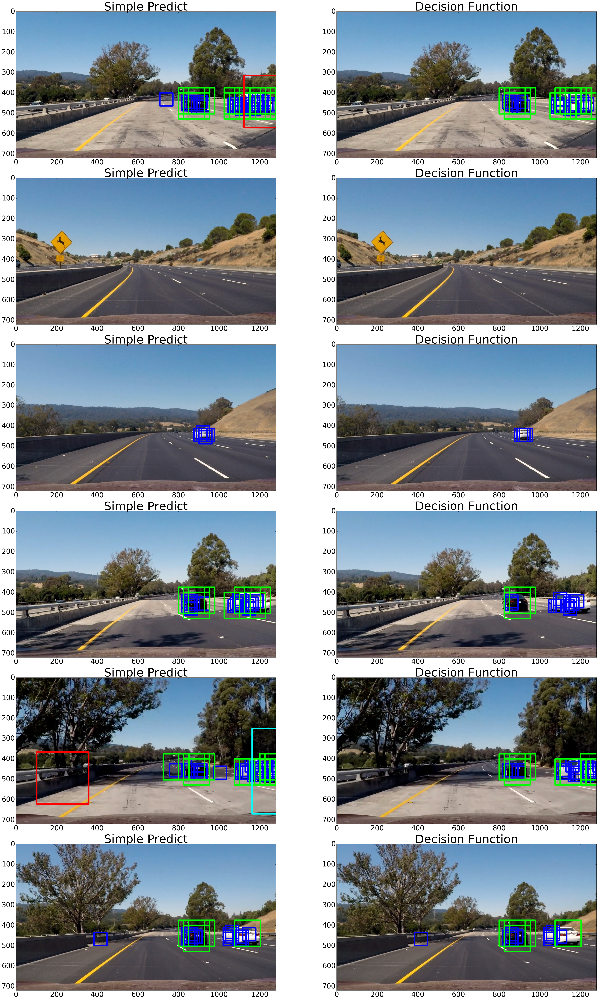

In [10]:
orient = 9  # HOG orientations
pix_per_cell = 8 # HOG pixels per cell
cell_per_block = 2 # HOG cells per block
hog_channel = 0 # Can be 0, 1, 2, or "ALL"
spatial_size = (32, 32) # Spatial binning dimensions
hist_bins = 32    # Number of histogram bins
spatial_feat = True # Spatial features on or off
hist_feat = True # Histogram features on or off
hog_feat = True # HOG features on or off
y_start_stop = [None, None] # Min and max in y to search in slide_window()

test_images_window = []
test_images_labels = []
test_images_final = []

test_images_window_decfn = []
test_images_labels_decfn = []
test_images_final_decfn = []
test_images = glob.glob('test_images/*.jpg')

for f_path in test_images:
    image = scipy.misc.imread(f_path,flatten=False, mode='RGB')
    
    # Using simple predict
    box_image, heatmap_image, threshold_heatmap_image, labels_image, final_image = pipeline(image)
    test_images_window.append(box_image)
    test_images_labels.append(labels_image)   
    test_images_final.append(final_image)
    
    # Using decision function
    box_image, heatmap_image, threshold_heatmap_image, labels_image, final_image = pipeline(image, dec_function = True)
    test_images_window_decfn.append(box_image)
    test_images_labels_decfn.append(labels_image)   
    test_images_final_decfn.append(final_image)
    

fig = plt.figure(figsize=(50, 60))

# Draw bounding boxes using predict
count=0
for i in range(1,12,2):
    fig.add_subplot(6, 2, i)
    plt.imshow(test_images_window[count])
    plt.xticks(fontsize = 30)
    plt.yticks(fontsize = 30)
    plt.title('Simple Predict', fontsize=50)
    plt.tight_layout()
    count += 1

# Draw bounding boxes using decision function > 0.5
count=0 
for i in range(2,13,2):
    fig.add_subplot(6, 2, i)
    plt.imshow(test_images_window_decfn[count])
    plt.xticks(fontsize = 30)
    plt.yticks(fontsize = 30)
    plt.title('Decision Function', fontsize=50)
    plt.tight_layout()
    count += 1

fig.savefig('output_images/PredictvsDecisionFunction.png')

print('Done')

## Step 11: Process Final Detected Images

Done


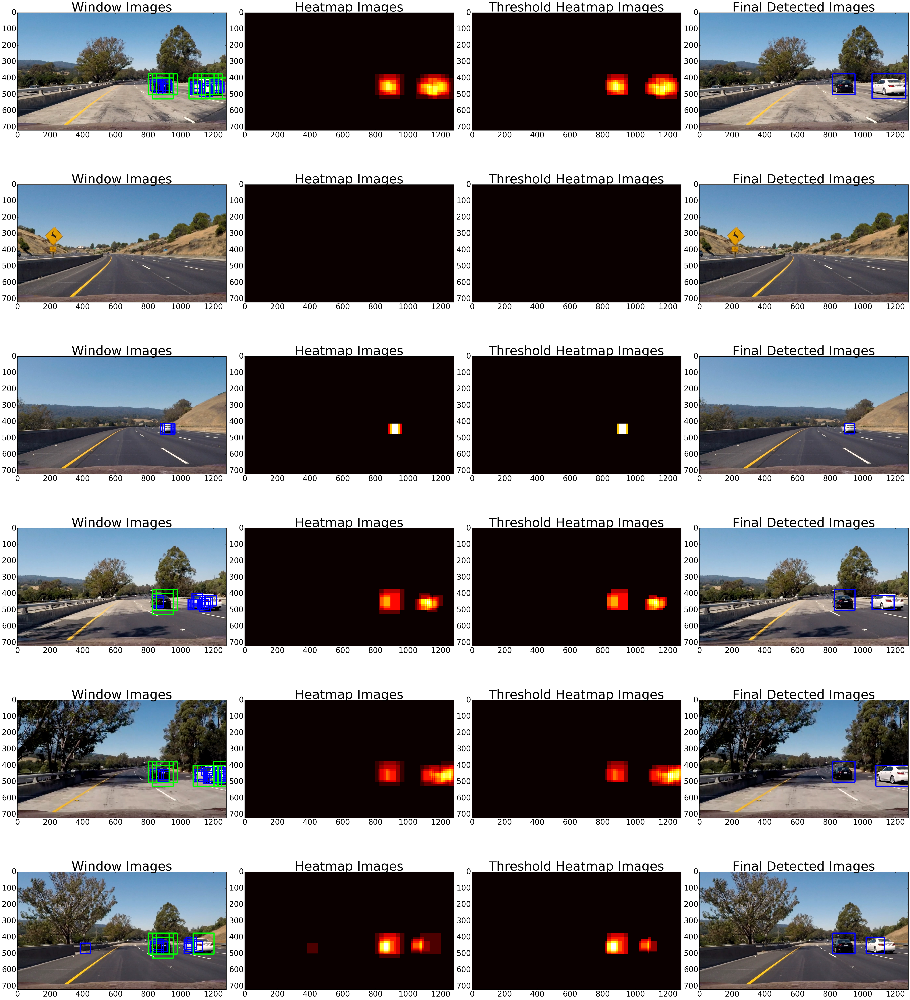

In [11]:
orient = 9  # HOG orientations
pix_per_cell = 8 # HOG pixels per cell
cell_per_block = 2 # HOG cells per block
hog_channel = 0 # Can be 0, 1, 2, or "ALL"
spatial_size = (32, 32) # Spatial binning dimensions
hist_bins = 32    # Number of histogram bins
spatial_feat = True # Spatial features on or off
hist_feat = True # Histogram features on or off
hog_feat = True # HOG features on or off
y_start_stop = [None, None] # Min and max in y to search in slide_window()

test_images_window = []
test_images_heatmap = []
test_images_threshold_heatmap = []
test_images_final = []
test_images = glob.glob('test_images/*.jpg')

for f_path in test_images:
    image = scipy.misc.imread(f_path,flatten=False, mode='RGB')
    box_image, heatmap_image, threshold_heatmap_image, labels_image, final_image = pipeline(image, dec_function=True)
    
    test_images_window.append(box_image)
    test_images_heatmap.append(heatmap_image)
    test_images_threshold_heatmap.append(threshold_heatmap_image)
    test_images_final.append(final_image)

fig = plt.figure(figsize=(50, 60))

# Draw bounding boxes based on initial detection
count=0
for i in range(1,22,4):
    fig.add_subplot(6, 4, i)
    plt.imshow(test_images_window[count])
    plt.xticks(fontsize = 30)
    plt.yticks(fontsize = 30)
    plt.title('Window Images', fontsize=50)
    plt.tight_layout()
    count += 1

# Draw heatmap based on bounding boxes
count=0 
for i in range(2,23,4):
    fig.add_subplot(6, 4, i)
    plt.imshow(test_images_heatmap[count], cmap='hot')
    plt.xticks(fontsize = 30)
    plt.yticks(fontsize = 30)
    plt.title('Heatmap Images', fontsize=50)
    plt.tight_layout()
    count += 1
    
# Draw heatmap based on threshold value
count=0 
for i in range(3,24,4):
    fig.add_subplot(6, 4, i)
    plt.imshow(test_images_threshold_heatmap[count], cmap='hot')
    plt.xticks(fontsize = 30)
    plt.yticks(fontsize = 30)
    plt.title('Threshold Heatmap Images', fontsize=50)
    plt.tight_layout()
    count += 1

# Draw final detected image with single bounding box over individual car
count=0 
for i in range(4,25,4):
    fig.add_subplot(6, 4, i)
    plt.imshow(test_images_final[count])
    plt.xticks(fontsize = 30)
    plt.yticks(fontsize = 30)
    plt.title('Final Detected Images', fontsize=50)
    plt.tight_layout()
    count += 1

fig.savefig('output_images/window_heatmap_thresholdheatmap_finalimg.png')

print('Done')

## Step 12: Define Class for Car Tracking Across Frames

In [12]:
# Define a class to receive the characteristics of each line detection

class CarTracking():
    def __init__(self):
        
        # define number of average frames to obtain.
        self.n = 5
        
        # define frame_counter to track number of frames
        self.frame_counter = 0
        
        # define list to hold last n number of heatmaps
        self.recent_heatmaps = []
        
        # variable to store total raw and threshold heatmap
        self.total_raw_heatmaps = None 
        self.total_threshold_heatmaps = None
        
        # image labels
        self.final_label = None
    
    # function to add all heatmaps in self.recent_heatmaps
    def add_heatmaps(self):

        self.total_raw_heatmaps = self.recent_heatmaps[0] + self.recent_heatmaps[1] + self.recent_heatmaps[2] + \
                                     self.recent_heatmaps[3] + self.recent_heatmaps[4]

    # function to update label value
    def update_label(self):

        self.total_threshold_heatmaps = apply_threshold(self.total_raw_heatmaps, 3)
        self.final_label = label(self.total_threshold_heatmaps)


print('Done')


Done


## Step 13: Define functions for processing of video images used for troubleshooting

In [13]:
from moviepy.editor import VideoFileClip, clips_array

# function to output current frame heatmap
def process_current_heatmap(image):
    
    box_image, heatmap_image, threshold_heatmap_image, labels_image, final_image = pipeline(image, dec_function=True)
        
    return np.dstack((heatmap_image,heatmap_image,heatmap_image))

# function to output threshold heatmaps over last 5 frames
def process_threshold_heatmap(image):

    if CarsTracked.total_threshold_heatmaps == None:
        return image
    else:
        return np.dstack((CarsTracked.total_threshold_heatmaps, CarsTracked.total_threshold_heatmaps, CarsTracked.total_threshold_heatmaps))

# function to output final video image with single bounding box
def process_video(image):
    box_image, heatmap_image, threshold_heatmap_image, labels_image, final_image = pipeline(image, dec_function=True)
    
    if len(CarsTracked.recent_heatmaps) < CarsTracked.n:
        CarsTracked.recent_heatmaps.append(heatmap_image)
        CarsTracked.frame_counter += 1
    else:
        CarsTracked.recent_heatmaps.pop(0)
        CarsTracked.recent_heatmaps.append(heatmap_image)
        
        
    if CarsTracked.frame_counter >= CarsTracked.n:
        CarsTracked.add_heatmaps()
        CarsTracked.update_label()
        averaged_image = draw_labeled_bboxes(image, CarsTracked.final_label)
    else:
        averaged_image = image
    
    return averaged_image

print('Done')

Done


## Step 14: Create composite video for troubleshooting video  between 5 - 10 sec

In [14]:
CarsTracked = CarTracking()

project_output = 'project_video_5_10.mp4'
clip1 = VideoFileClip('project_video.mp4').subclip(5,10)

current_heatmap_clip = clip1.fl_image(process_current_heatmap)
final_clip = clip1.fl_image(process_video)
threshold_heatmap_clip = clip1.fl_image(process_threshold_heatmap)

multiple_clips = clips_array([[current_heatmap_clip, threshold_heatmap_clip, final_clip]])
%time multiple_clips.write_videofile(project_output, audio=False)
print('Done')

[MoviePy] >>>> Building video project_video_5_10.mp4
[MoviePy] Writing video project_video_5_10.mp4


 99%|███████████████████████████████████████▋| 125/126 [17:37<00:08,  8.46s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_5_10.mp4 

Wall time: 17min 39s
Done


## Step 15: Create composite video for troubleshooting video  between 26 - 37 sec

In [15]:
CarsTracked = CarTracking()

project_output = 'project_video_26_37.mp4'
clip1 = VideoFileClip('project_video.mp4').subclip(26,37)

current_heatmap_clip = clip1.fl_image(process_current_heatmap)
final_clip = clip1.fl_image(process_video)
threshold_heatmap_clip = clip1.fl_image(process_threshold_heatmap)

multiple_clips = clips_array([[current_heatmap_clip, threshold_heatmap_clip, final_clip]])
%time multiple_clips.write_videofile(project_output, audio=False)
print('Done')

[MoviePy] >>>> Building video project_video_26_37.mp4
[MoviePy] Writing video project_video_26_37.mp4


100%|███████████████████████████████████████▊| 275/276 [39:52<00:08,  8.69s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_26_37.mp4 

Wall time: 39min 54s
Done


## Step 16: Final processing of video

In [16]:
CarsTracked = CarTracking()

project_output = 'project_video_final.mp4'
clip1 = VideoFileClip('project_video.mp4')

print('Number of frames per second:', clip1.fps)
project_clip = clip1.fl_image(process_video)
%time project_clip.write_videofile(project_output, audio=False)
print('Done')

Number of frames per second: 25.0
[MoviePy] >>>> Building video project_video_final.mp4
[MoviePy] Writing video project_video_final.mp4


100%|███████████████████████████████████▉| 1260/1261 [1:35:06<00:04,  4.19s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_final.mp4 

Wall time: 1h 35min 8s
Done
